In [173]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import torch.nn as nn
from torch import nn, optim
from torch.utils.data import Dataset
from torchvision import transforms
import random
import torch.nn.functional as F
import kornia
import torchvision.transforms as T

In [54]:
# List files in the DIV2K_train_HR directory
hr_dir = 'DIV2K/DIV2K_train_HR/DIV2K_train_HR/'
print(os.listdir(hr_dir)[:10])  # Show the first 10 files

['0298.png', '0267.png', '0501.png', '0515.png', '0273.png', '0529.png', '0703.png', '0065.png', '0071.png', '0717.png']


In [47]:
# Set up paths for training and validation directories
train_hr_dir = 'DIV2K/DIV2K_train_HR/DIV2K_train_HR/'
valid_hr_dir = 'DIV2K/DIV2K_valid_HR/DIV2K_valid_HR/'

In [53]:
# train_images, test_images = train_test_split(train_images, test_size=0.1, random_state=42)
# train_images
train_images = os.listdir(train_hr_dir)
val_images = os.listdir(valid_hr_dir)
print(f'Train Before Splitting: {len(train_images)}')

test_images = random.sample(train_images, 100)
train_images = [img for img in train_images if img not in test_images]

print(f'Train After Split: {len(train_images)}, Test: {len(test_images)}, Validation: {len(val_images)}')


Train Before Splitting: 800
Train After Split: 700, Test: 100, Validation: 100


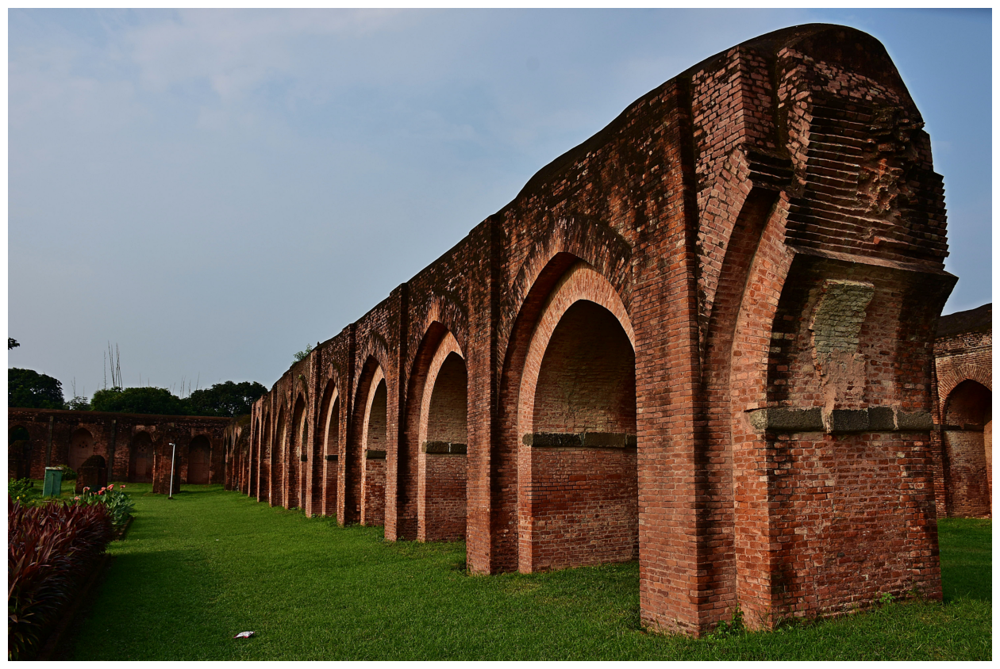

In [52]:
# Load an example image
example_image_path = os.path.join(hr_dir, '0283.png')  # Change the filename as needed
image = Image.open(example_image_path)

# Display the image
plt.figure(figsize=(16, 16))
plt.imshow(image)
plt.axis('off')  # Hide axis labels
plt.show()

In [55]:
print(image.size)

(2040, 1356)


In [107]:
class DIV2KDataset(Dataset):
    def __init__(self, image_list, hr_dir, scale_factor=16, target_size=(128, 128), transform=None):
        super(DIV2KDataset, self).__init__()
        self.image_list = image_list
        self.hr_dir = hr_dir
        self.scale_factor = scale_factor
        self.target_size = target_size
        self.transform = transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        # Load the high-resolution image
        image_path = os.path.join(self.hr_dir, self.image_list[idx])
        image = Image.open(image_path).convert('RGB')
        
        if image.size[0]<image.size[1]: 
                image = image.rotate(-90, expand=True)
        
        # Resize HR image to the target size
        # size_1, size_2= 2040,1356
        image = image.resize(target_size, Image.BICUBIC)
        
        # Resize HR image to the target size
        hr_image = image.resize((image.size[0]//scale_factor, image.size[1]//scale_factor), Image.BICUBIC) # (510,339)
        # Generate the low-resolution (LR) image by downscaling the resized HR image
        lr_image = hr_image.resize((hr_image.size[0]//scale_factor, hr_image.size[1]//scale_factor), Image.BICUBIC) # (127,84) 
        # lr_image = lr_image.resize((hr_image.size[0]*2, hr_image.size[1]*2)) # *2
        # # Resize HR image to the target size
        # hr_image = hr_image.resize(self.target_size, Image.BICUBIC)
        # 
        # # Generate the low-resolution (LR) image by downscaling the resized HR image
        # lr_image = hr_image.resize(
        #     (self.target_size[0] // self.scale_factor, self.target_size[1] // self.scale_factor),
        #     Image.BICUBIC
        # )

        # # Upscale the LR image back to the target HR size
        # lr_image = lr_image.resize(self.target_size, Image.BICUBIC)
        # if self.transform:
        # Apply the transformations
        hr_image = self.transform(hr_image)
        lr_image = self.transform(lr_image)
        # Return both the low-resolution and high-resolution images
        return  lr_image, hr_image

In [144]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
# Create datasets
scale_factor = 4
target_size = (2048,1024) #int(image.size) // scale_factor

train_dataset = DIV2KDataset(train_images, train_hr_dir, scale_factor=scale_factor, target_size=target_size, transform=transform)
valid_dataset = DIV2KDataset(os.listdir(valid_hr_dir), valid_hr_dir, scale_factor=scale_factor, target_size=target_size, transform=transform)
test_dataset = DIV2KDataset(test_images, train_hr_dir, scale_factor=scale_factor, target_size=target_size, transform=transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False, num_workers=0)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=0)

In [145]:
for lr_imgs, hr_imgs in train_loader:
    print(f"Low-resolution images batch shape: {lr_imgs.shape}")
    print(f"High-resolution images batch shape: {hr_imgs.shape}")
    break
    

Low-resolution images batch shape: torch.Size([16, 3, 64, 128])
High-resolution images batch shape: torch.Size([16, 3, 256, 512])


Low-resolution image size: (128, 64)
High-resolution image size: (512, 256)


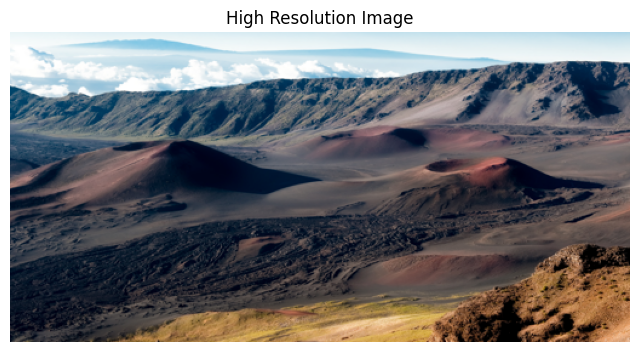

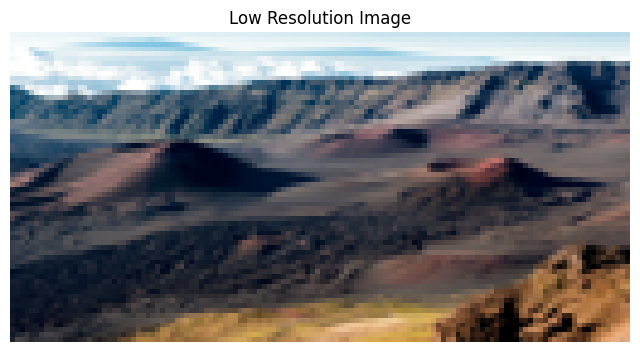

In [146]:
# Define the inverse normalization transformation
inverse_transform = transforms.Compose([
    transforms.Normalize((-1, -1, -1), (2, 2, 2)),  # Undo the normalization
    transforms.ToPILImage()  # Convert back to a PIL image
])

# Assuming lr_image and hr_image are from the DataLoader
for lr_images, hr_images in train_loader:
    # Take the first image from the batch
    # lr_image = lr_images[0]
    # hr_image = hr_images[0]
    # 
    # Un-normalize and convert to PIL image
    lr_image_pil = inverse_transform(lr_image)
    hr_image_pil = inverse_transform(hr_image)
    
    # Display the images
    print(f"Low-resolution image size: {lr_image_pil.size}")
    print(f"High-resolution image size: {hr_image_pil.size}")

    plt.figure(figsize=(8, 8))
    plt.title("High Resolution Image")
    plt.imshow(hr_image_pil)
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.title("Low Resolution Image")
    plt.imshow(lr_image_pil)
    plt.axis('off')
    plt.show()
    
    break  # Display only the first batch


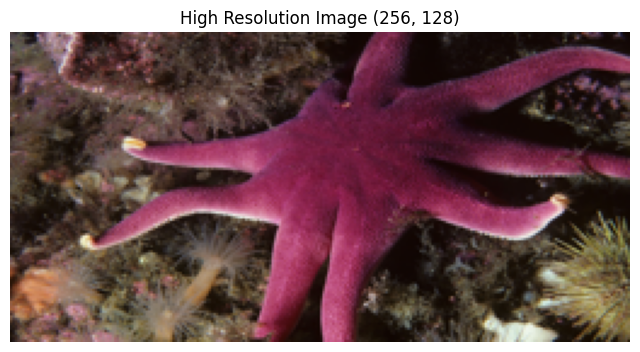

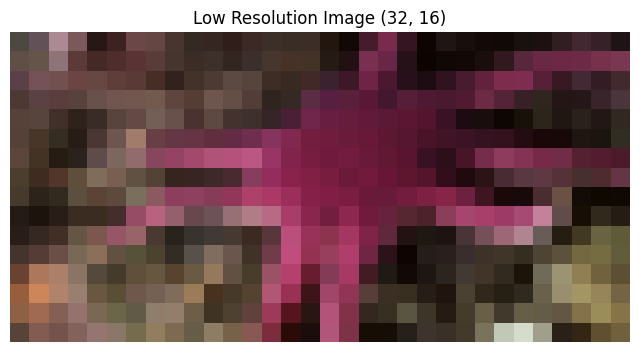

(32, 16) (256, 128)


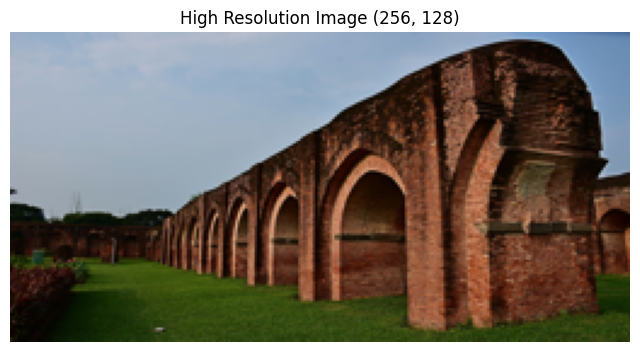

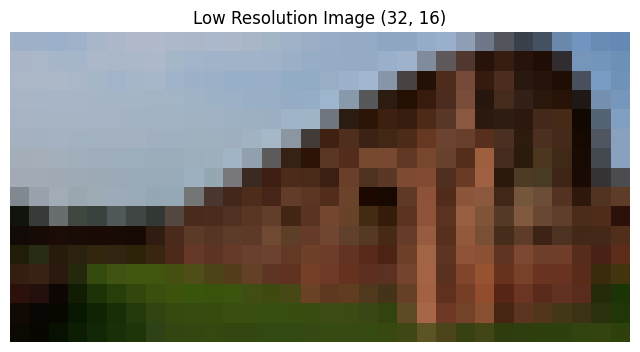

(32, 16) (256, 128)


In [138]:
# Function to display a pair of low-resolution and high-resolution images
def display_lr_hr_images(image_name, dataset, hr_dir, target_size=(256, 256), scale_factor=4):
    # Load the image
    image_path = os.path.join(hr_dir, image_name)
    hr_image = Image.open(image_path).convert('RGB')

    # Resize HR image to the target size
    hr_image_resized = hr_image.resize(target_size, Image.BICUBIC)

    # Generate the low-resolution (LR) image by downscaling the resized HR image
    lr_image = hr_image_resized.resize(
        (target_size[0] // scale_factor, target_size[1] // scale_factor),
        Image.BICUBIC
    )

    # Convert the images to RGB format (already in RGB if no additional transform)
    lr_image_rgb = lr_image.convert('RGB')
    hr_image_rgb = hr_image_resized.convert('RGB')

    # Display the high-resolution image
    plt.figure(figsize=(8, 8))
    plt.title(f'High Resolution Image {target_size}')
    plt.imshow(hr_image_rgb)
    plt.axis('off')  # Hide axis labels
    plt.show()

    # Display the low-resolution image
    plt.figure(figsize=(8, 8))
    plt.title(f'Low Resolution Image {(target_size[0]//scale_factor, target_size[1]//scale_factor)}')
    plt.imshow(lr_image_rgb)
    plt.axis('off')  # Hide axis labels
    plt.show()
    
    print(lr_image_rgb.size, hr_image_rgb.size)
# Example usage
# Choose specific image filenames from your dataset
chosen_images = ['0001.png', '0283.png']  # Replace with the image filenames you want

# Display the chosen images
for image_name in chosen_images:
    display_lr_hr_images(image_name, train_dataset, train_hr_dir, target_size=(256, 128), scale_factor=8)


## Models

In [30]:
# class SRCNN(nn.Module): 
#     def __init__(self):
#         super(SRCNN, self).__init__()
#         self.conv1 = nn.Conv2d(3, 64, kernel_size=9, padding=4) #Input size  (127,84)
#         self.conv2 = nn.Conv2d(64, 32, kernel_size=1, padding=0) 
#         self.conv3 = nn.Conv2d(32, 3, kernel_size=5, padding=2) #Output of conv3 size (510,339)
#         self.relu = nn.ReLU()
# 
#     def forward(self, x):
#         x = self.relu(self.conv1(x))
#         x = self.relu(self.conv2(x))
#         x = self.conv3(x)
#         return x
# 
# srcnn_model = SRCNN()

In [134]:
class SRCNN(nn.Module):
    def __init__(self):
        super(SRCNN, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=9, padding=4)  # Keeps input size (64, 128)
        self.conv2 = nn.Conv2d(64, 32, kernel_size=1, padding=0)
        
        # Transposed convolution to increase the dimensions
        self.deconv = nn.ConvTranspose2d(32, 32, kernel_size=4, stride=(4, 4), padding=0, output_padding=(0, 0))  # Upscales to (512, 256)
        
        # Adjusting the final convolution to achieve the desired output size
        self.conv3 = nn.Conv2d(32, 3, kernel_size=3, padding=1)  # Output size (256, 512)
        
        self.relu = nn.ReLU()

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.relu(self.conv2(x))
        x = self.relu(self.deconv(x))  # Transposed convolution to upscale
        x = self.conv3(x)
        return x

# Instantiate the model
# srcnn_model = SRCNN()
# 
# # Example usage
# input_tensor = torch.randn(1, 3, 16, 32)  # A random input tensor with size (3, 64, 128)
# output_tensor = srcnn_model(input_tensor)
# 
# print(f"Input size: {input_tensor.shape}")
# print(f"Output size: {output_tensor.shape}")


Input size: torch.Size([1, 3, 16, 32])
Output size: torch.Size([1, 3, 64, 128])


In [3]:
class VDSR(nn.Module):
    def __init__(self, num_layers=18):
        super(VDSR, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.relu = nn.ReLU()
        
        layers = []
        for _ in range(num_layers):
            layers.append(nn.Conv2d(64, 64, kernel_size=3, padding=1))
            layers.append(nn.ReLU())
        self.layers = nn.Sequential(*layers)
        
        self.conv2 = nn.Conv2d(64, 3, kernel_size=3, padding=1)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.layers(x)
        x = self.conv2(x)
        return x

vdsr_model = VDSR()

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)

    def forward(self, x):
        residual = x
        x = self.relu(self.conv1(x))
        x = self.conv2(x)
        x += residual
        return x

class ResNetSR(nn.Module):
    def __init__(self, num_blocks=16):
        super(ResNetSR, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, padding=1)
        self.relu = nn.ReLU()

        layers = []
        for _ in range(num_blocks):
            layers.append(ResidualBlock(64))
        self.res_blocks = nn.Sequential(*layers)

        self.conv2 = nn.Conv2d(64, 3, kernel_size=3, padding=1)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.res_blocks(x)
        x = self.conv2(x)
        return x

resnet_model = ResNetSR()

GAN MODEL:

In [ ]:
class GeneratorResBlock(nn.Module):
    def __init__(self, in_channels):
        super(GeneratorResBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)

    def forward(self, x):
        residual = x
        x = self.relu(self.conv1(x))
        x = self.conv2(x)
        x += residual
        return x

class SRGAN_Generator(nn.Module):
    def __init__(self, num_res_blocks=16):
        super(SRGAN_Generator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=9, padding=4)
        self.relu = nn.ReLU()

        layers = []
        for _ in range(num_res_blocks):
            layers.append(GeneratorResBlock(64))
        self.res_blocks = nn.Sequential(*layers)

        self.conv2 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.upsample = nn.Conv2d(64, 3, kernel_size=9, padding=4)

    def forward(self, x):
        x = self.relu(self.conv1(x))
        x = self.res_blocks(x)
        x = self.conv2(x)
        x = self.upsample(x)
        return x

generator = SRGAN_Generator()


In [4]:
class SRGAN_Discriminator(nn.Module):
    def __init__(self):
        super(SRGAN_Discriminator, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1)
        self.leaky_relu = nn.LeakyReLU(0.2)

        self.layers = nn.Sequential(
            nn.Conv2d(64, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Flatten(),
            nn.Linear(128*16*16, 1024),
            nn.LeakyReLU(0.2),
            nn.Linear(1024, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.leaky_relu(self.conv1(x))
        x = self.layers(x)
        return x

discriminator = SRGAN_Discriminator()

In [ ]:
class SimpleDiffusionModel(nn.Module):
    def __init__(self, in_channels=3, base_channels=64):
        super(SimpleDiffusionModel, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, base_channels, 3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(base_channels, base_channels*2, 3, stride=2, padding=1),
            nn.ReLU(),
        )
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(base_channels*2, base_channels, 3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(base_channels, in_channels, 3, stride=2, padding=1, output_padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded

diffusion_model = SimpleDiffusionModel()


In [154]:
def save_checkpoint(model, epoch, val_loss, name_for_checkpoints, checkpoint_dir='checkpoints'):
    os.makedirs(checkpoint_dir, exist_ok=True)
    checkpoint_filename = f'{name_for_checkpoints}_epoch_{epoch+1}_val_loss_{val_loss:.4f}.pth'
    checkpoint_path = os.path.join(checkpoint_dir, checkpoint_filename)
    torch.save(model.state_dict(), checkpoint_path)
    print(f"Checkpoint saved: {checkpoint_path}")

In [155]:
def train_validate_test(model, train_loader, valid_loader, test_loader, criterion, optimizer, num_epochs=20, device='cuda', name_for_checkpoints=None):
    model = model.to(device)
    best_val_loss = float('inf')

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}...')
        
        # Training Phase
        model.train()
        train_loss = 0.0
        for lr_imgs, hr_imgs in train_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            outputs = model(lr_imgs)
            # print(outputs.size())
            # print(hr_imgs.size())
            loss = criterion(outputs, hr_imgs)
            train_loss += loss.item()

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        avg_train_loss = train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}')

        # Validation Phase
        model.eval()
        with torch.no_grad():
            val_loss = 0.0
            for lr_imgs, hr_imgs in valid_loader:
                lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
                outputs = model(lr_imgs)
                val_loss += criterion(outputs, hr_imgs).item()

        avg_val_loss = val_loss / len(valid_loader)
        val_losses.append(avg_val_loss)
        print(f"Epoch [{epoch+1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}")

        # Save checkpoint if it's the best model so far
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            save_checkpoint(model, epoch, avg_val_loss, name_for_checkpoints)

    # Plot training and validation loss
    plt.figure()
    plt.plot(range(1, num_epochs + 1), train_losses, label='Train Loss')
    plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()

    # # Test Phase (After Training)
    # model.eval()
    # with torch.no_grad():
    #     test_loss = 0.0
    #     for lr_imgs, hr_imgs in test_loader:
    #         lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
    #         outputs = model(lr_imgs)
    #         test_loss += criterion(outputs, hr_imgs).item()
    # 
    #     avg_test_loss = test_loss / len(test_loader)
    #     print(f"Test Loss: {avg_test_loss:.4f}")

    return model


In [156]:
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(device)

mps


Epoch 1/20...
Epoch [1/20], Train Loss: 0.1789
Epoch [1/20], Validation Loss: 0.1002
Checkpoint saved: checkpoints/srcnn_epoch_1_val_loss_0.1002.pth
Epoch 2/20...
Epoch [2/20], Train Loss: 0.0689
Epoch [2/20], Validation Loss: 0.0523
Checkpoint saved: checkpoints/srcnn_epoch_2_val_loss_0.0523.pth
Epoch 3/20...
Epoch [3/20], Train Loss: 0.0423
Epoch [3/20], Validation Loss: 0.0425
Checkpoint saved: checkpoints/srcnn_epoch_3_val_loss_0.0425.pth
Epoch 4/20...
Epoch [4/20], Train Loss: 0.0358
Epoch [4/20], Validation Loss: 0.0371
Checkpoint saved: checkpoints/srcnn_epoch_4_val_loss_0.0371.pth
Epoch 5/20...
Epoch [5/20], Train Loss: 0.0316
Epoch [5/20], Validation Loss: 0.0339
Checkpoint saved: checkpoints/srcnn_epoch_5_val_loss_0.0339.pth
Epoch 6/20...
Epoch [6/20], Train Loss: 0.0291
Epoch [6/20], Validation Loss: 0.0314
Checkpoint saved: checkpoints/srcnn_epoch_6_val_loss_0.0314.pth
Epoch 7/20...
Epoch [7/20], Train Loss: 0.0271
Epoch [7/20], Validation Loss: 0.0302
Checkpoint saved: che

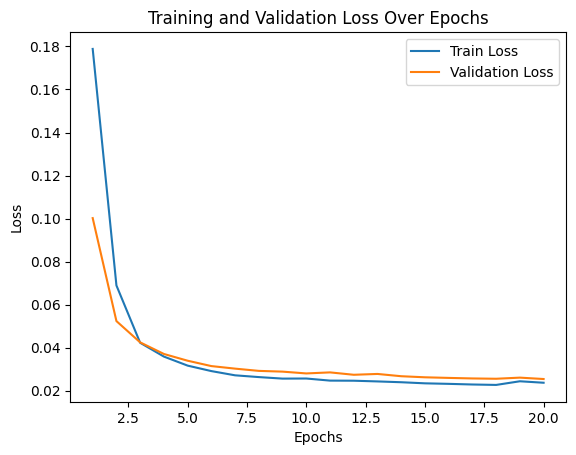

In [157]:
# Instantiate the model, loss function, and optimizer
name_for_checkpoints = ['srcnn']
srcnn_model = SRCNN()
criterion = nn.MSELoss()
optimizer = optim.Adam(srcnn_model.parameters(), lr=1e-3)

# Call the function with your DataLoaders and model
trained_model = train_validate_test(
    model=srcnn_model,
    train_loader=train_loader,
    valid_loader=valid_loader,
    test_loader=test_loader,
    criterion=criterion,
    optimizer=optimizer,
    num_epochs=20,
    device=device,
    name_for_checkpoints = name_for_checkpoints[0]
    )

# Evaluation

In [158]:
def calculate_psnr(output, target):
    mse = F.mse_loss(output, target)
    psnr = 10 * torch.log10(1 / mse)  # assuming images are normalized between [0, 1]
    return psnr.item()

In [171]:
def calculate_ssim(output, target):
    # SSIM expects images to be in range [0, 1]
    output = output.clamp(0, 1)
    target = target.clamp(0, 1)
    
    # Calculate SSIM
    ssim_value = kornia.metrics.ssim(output, target, window_size=11).mean()
    return ssim_value.item()

# # Example usage
# output = torch.rand(1, 3, 256, 256)  # Replace with your model output
# target = torch.rand(1, 3, 256, 256)  # Replace with your target image
# ssim_value = calculate_ssim(output, target)
# print(f"SSIM: {ssim_value}")

In [172]:
def evaluate_model(model, test_loader, device='mps'):
    model.eval()
    avg_psnr = 0.0
    avg_ssim = 0.0
    num_batches = len(test_loader)

    with torch.no_grad():
        for lr_imgs, hr_imgs in test_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            outputs = model(lr_imgs)

            # Calculate PSNR and SSIM
            psnr_value = calculate_psnr(outputs, hr_imgs)
            ssim_value = calculate_ssim(outputs, hr_imgs)

            avg_psnr += psnr_value
            avg_ssim += ssim_value

    avg_psnr /= num_batches
    avg_ssim /= num_batches

    print(f'Average PSNR: {avg_psnr:.4f} dB')
    print(f'Average SSIM: {avg_ssim:.4f}')

    return avg_psnr, avg_ssim

# Evaluate your trained model on the test set
evaluate_model(trained_model, test_loader, device=device)


Average PSNR: 16.5350 dB
Average SSIM: 0.7229


(16.535037449428014, 0.7228948814528329)

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


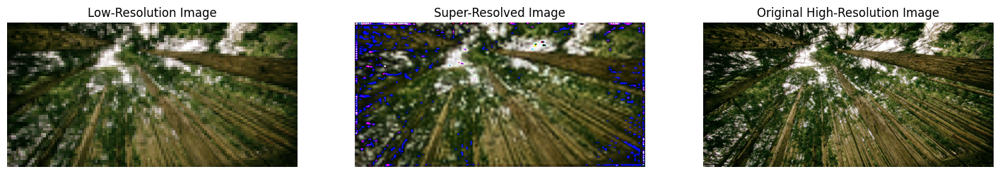

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


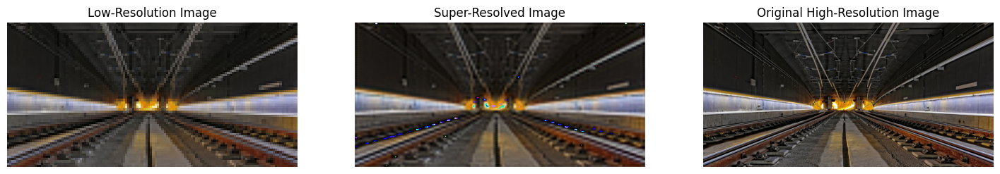

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


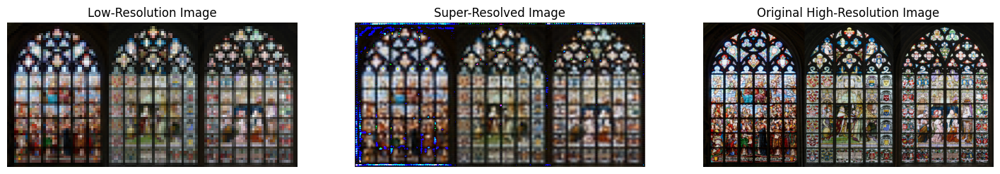

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


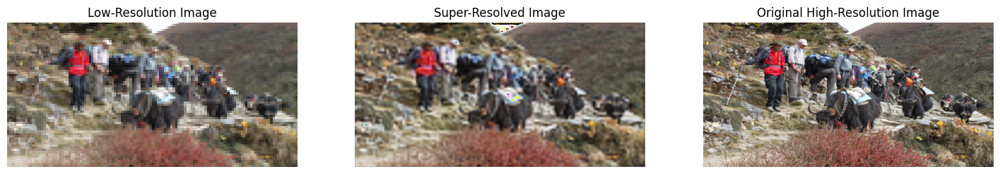

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


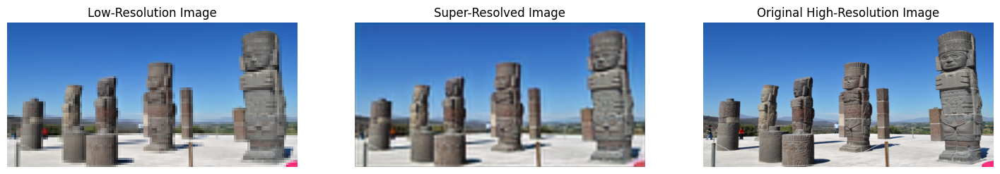

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


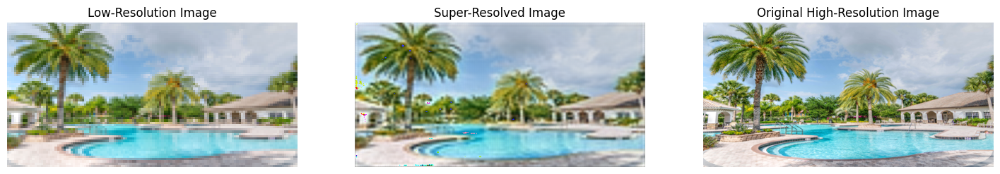

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


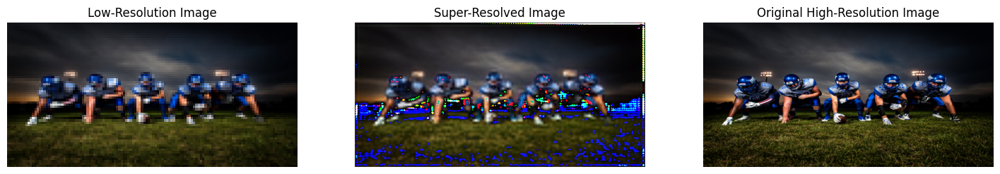

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


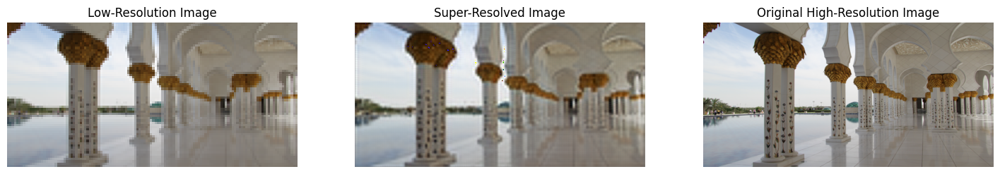

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


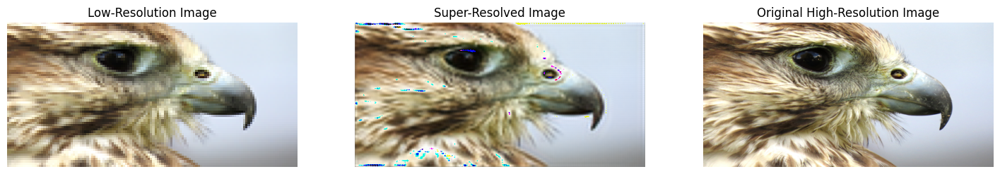

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


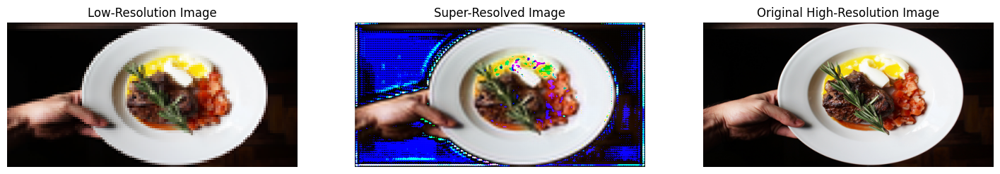

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


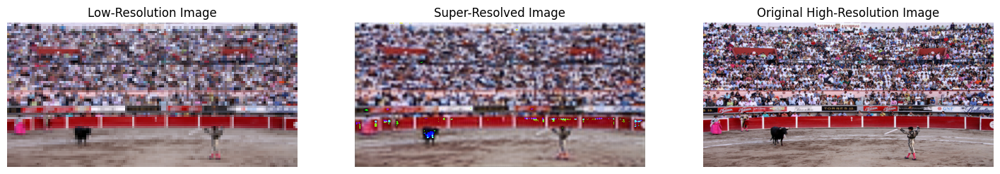

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


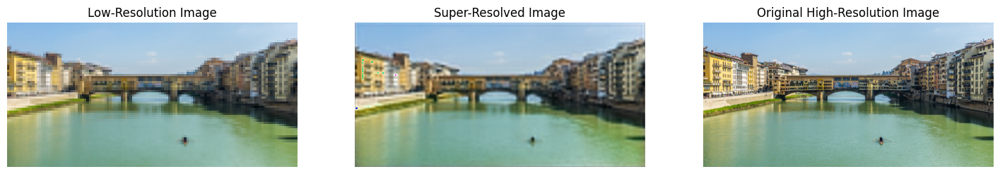

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


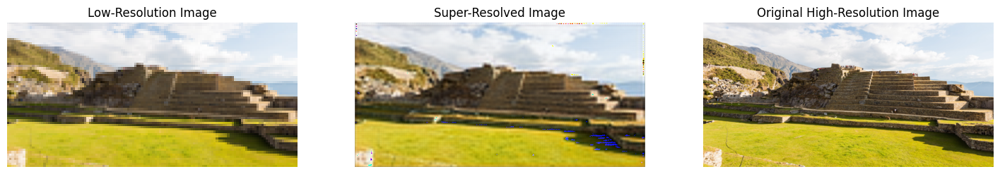

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


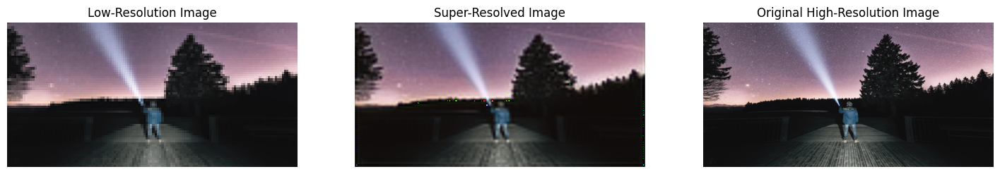

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


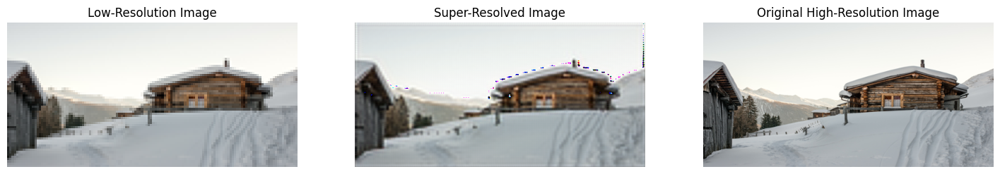

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


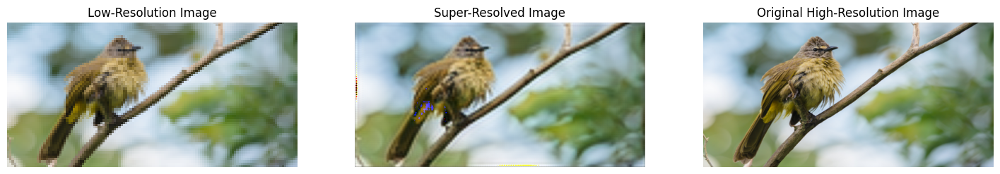

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


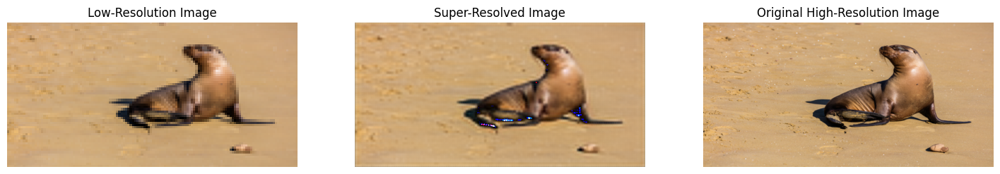

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


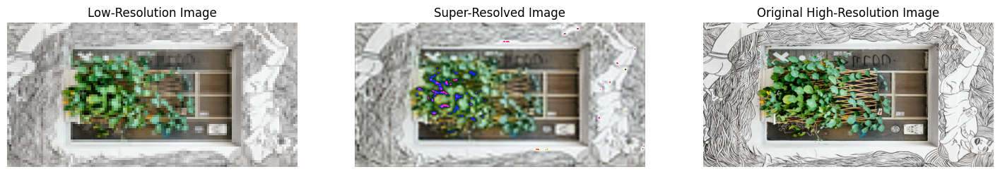

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


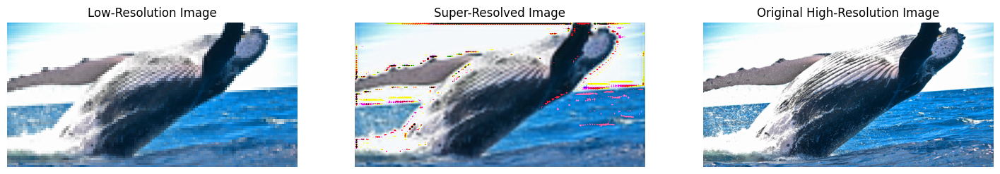

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


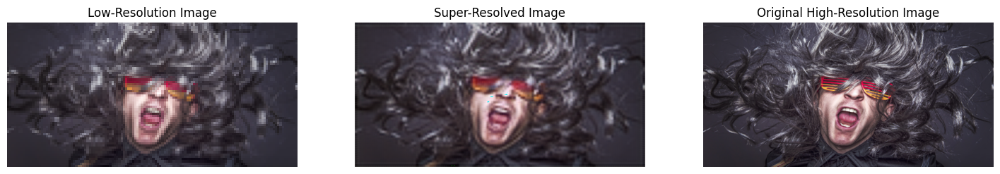

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


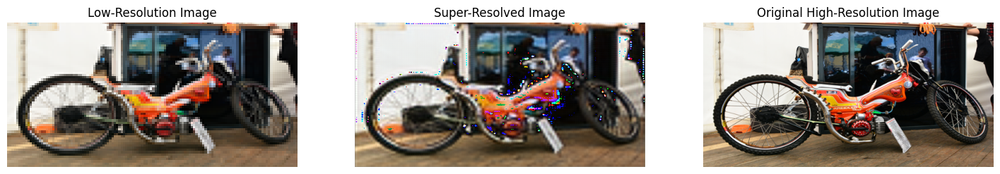

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


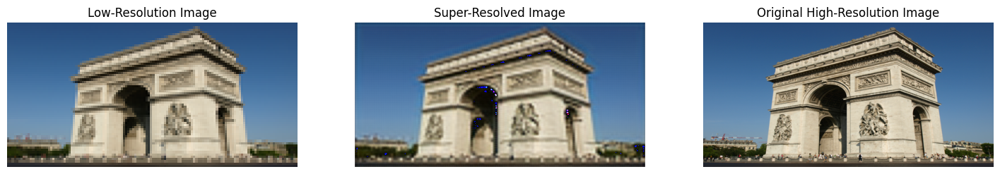

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


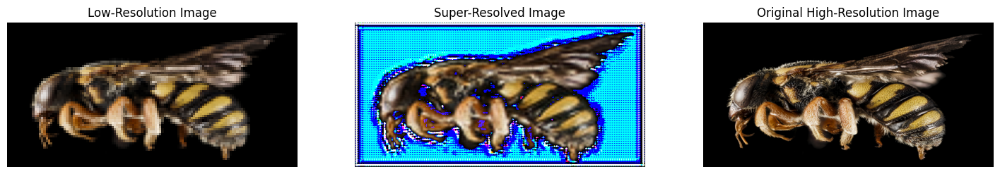

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


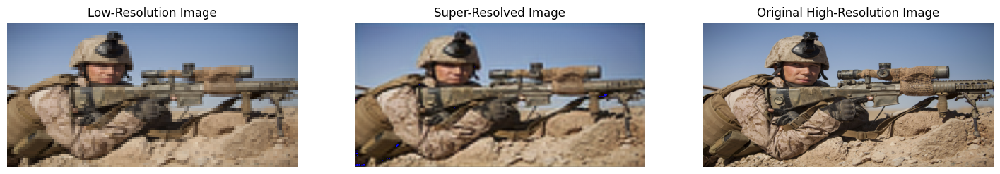

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


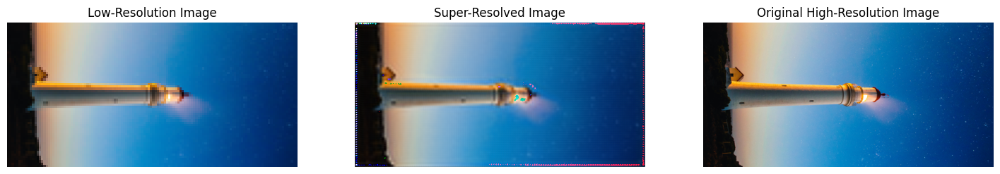

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


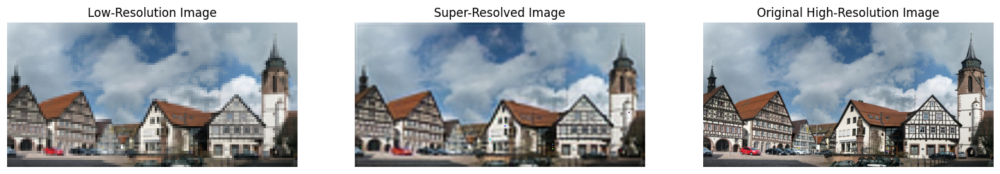

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


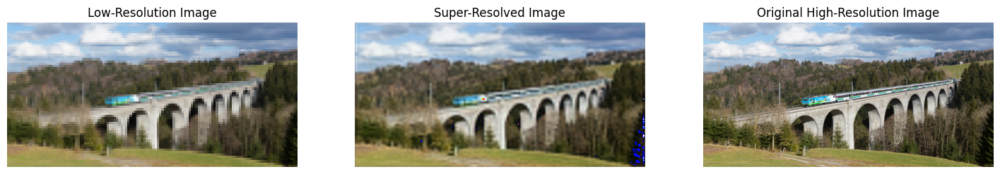

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


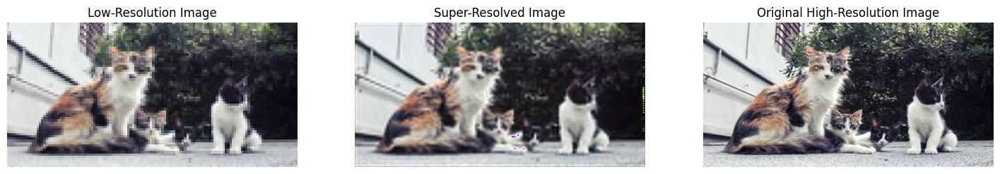

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


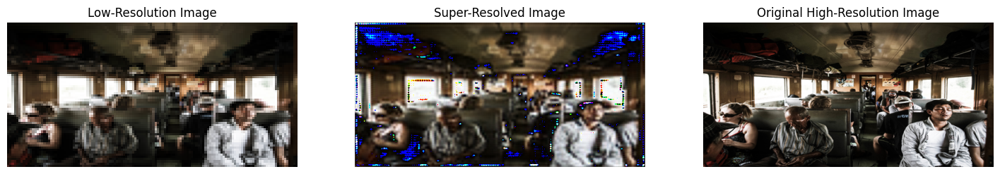

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


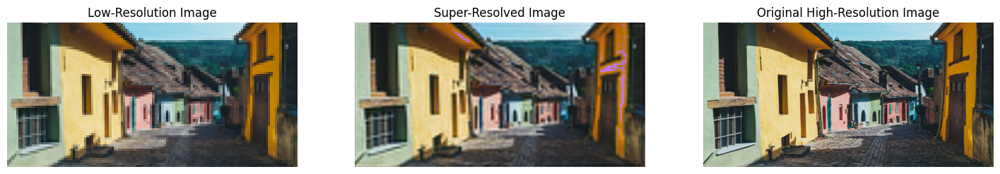

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


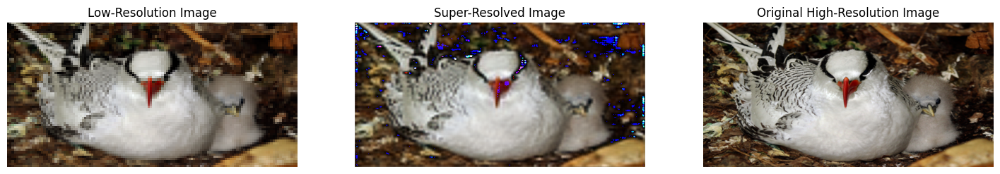

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


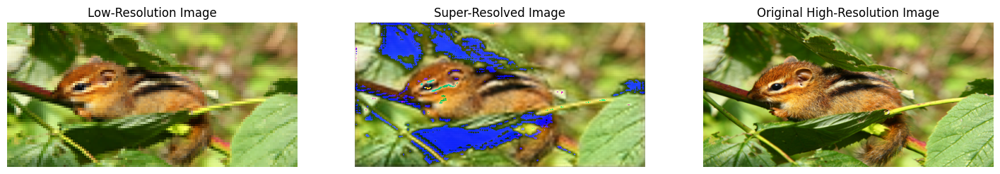

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


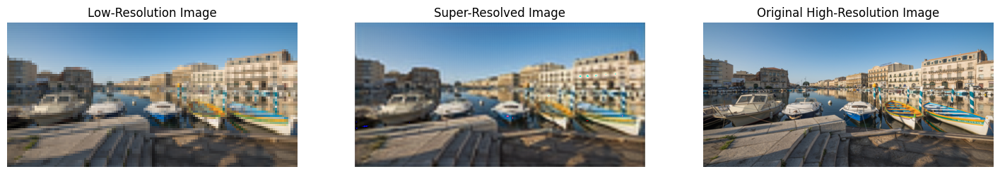

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


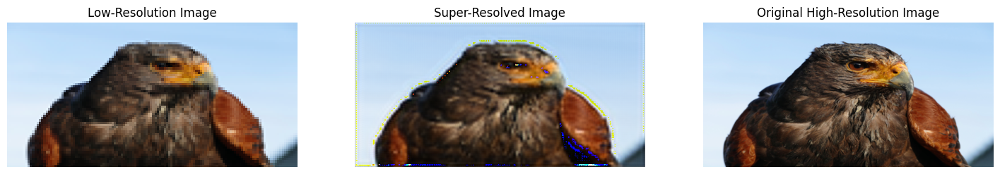

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


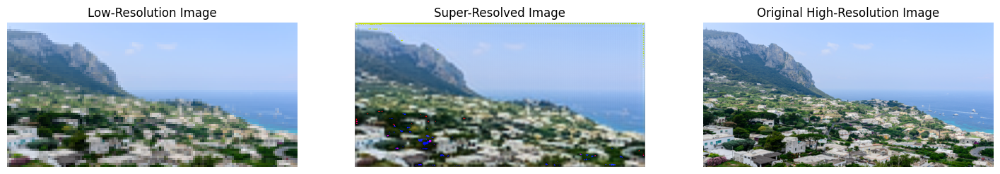

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


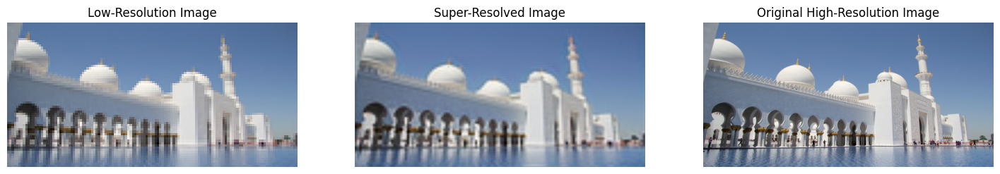

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


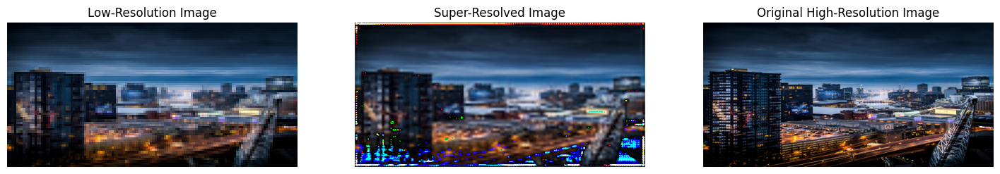

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


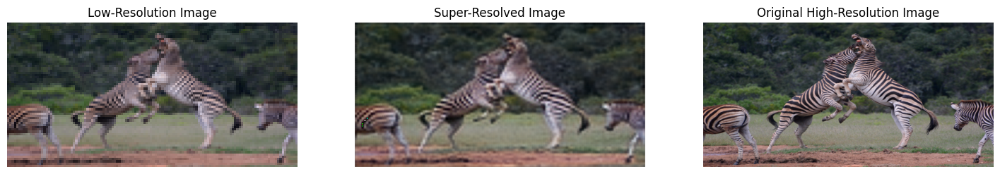

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


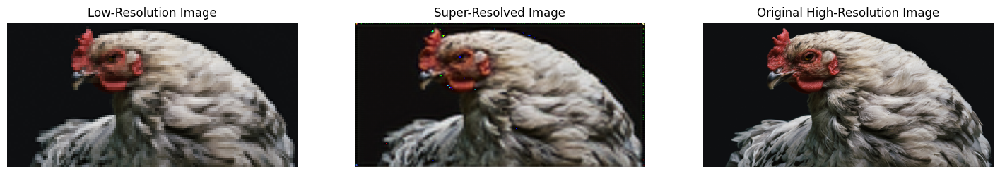

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


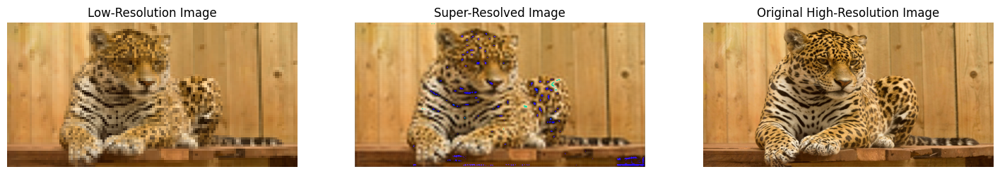

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


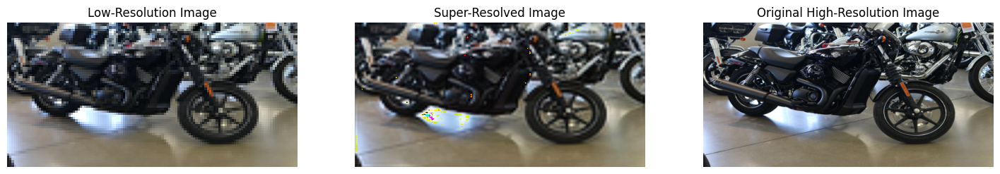

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


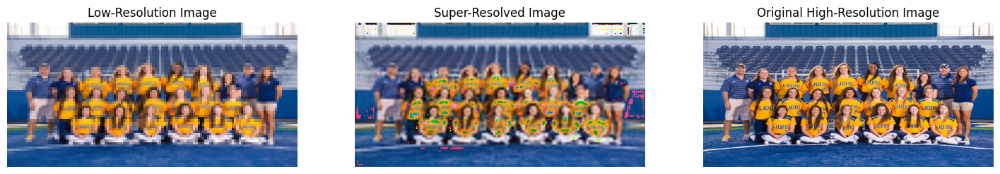

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


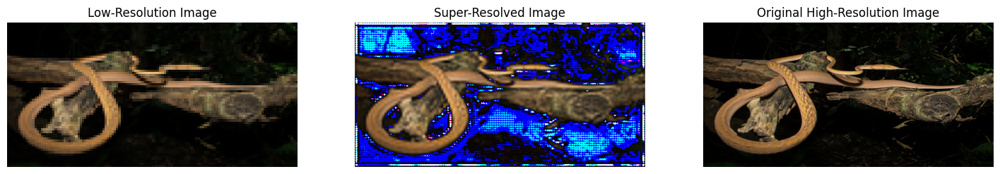

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


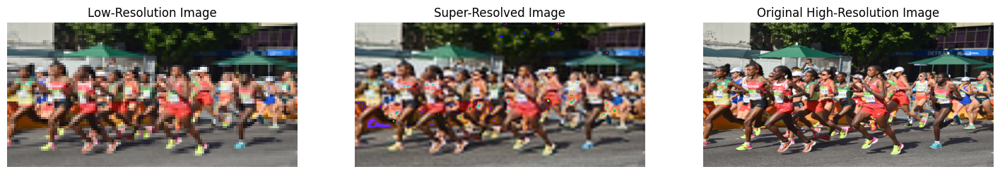

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


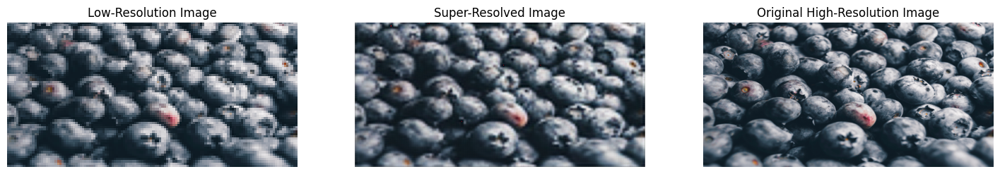

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


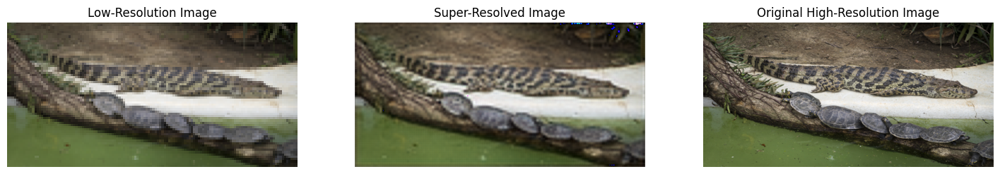

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


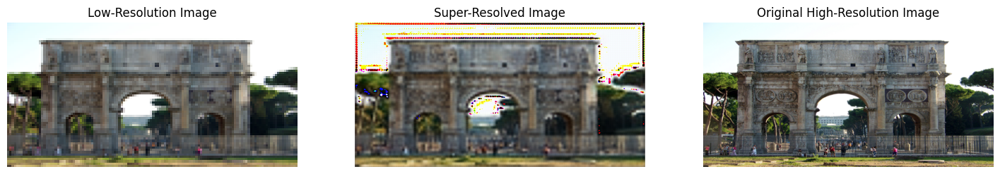

The size of the High-res id: (512, 256)
The size of the Trained-res id: (512, 256)
The size of the Low-res id: (128, 64)


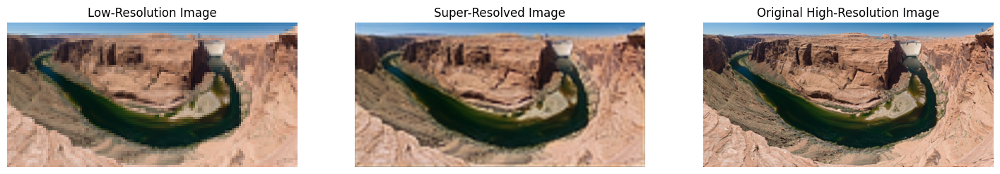

In [179]:
def display_comparison(model, test_loader, device='mps', num_images=3):
    # Set the model to evaluation mode
    model.eval()
    
    # Define an inverse transform to undo normalization
    inverse_transform = T.Compose([
        T.Normalize(mean=[-0.5 / 0.5, -0.5 / 0.5, -0.5 / 0.5], std=[1 / 0.5, 1 / 0.5, 1 / 0.5]),
        T.ToPILImage()
    ])
    
    # Process the first few images from the test loader
    with torch.no_grad():
        for i, (lr_imgs, hr_imgs) in enumerate(test_loader):
            if i >= num_images:
                break

            # Move images to the appropriate device
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            
            # Generate the super-resolved image using the model
            sr_imgs = model(lr_imgs)
            
            # Loop through the batch
            for j in range(lr_imgs.size(0)):
                # Get the images
                lr_image = lr_imgs[j].cpu()
                sr_image = sr_imgs[j].cpu()
                hr_image = hr_imgs[j].cpu()
                
                # Undo normalization and convert back to PIL
                lr_image_pil = inverse_transform(lr_image)
                sr_image_pil = inverse_transform(sr_image)
                hr_image_pil = inverse_transform(hr_image)
                print(f'The size of the High-res id: {hr_image_pil.size}')
                print(f'The size of the Trained-res id: {sr_image_pil.size}')
                print(f'The size of the Low-res id: {lr_image_pil.size}')
                # Display the images side by side
                plt.figure(figsize=(18, 6))
                
                plt.subplot(1, 3, 1)
                plt.title('Low-Resolution Image')
                plt.imshow(lr_image_pil)
                plt.axis('off')
                
                plt.subplot(1, 3, 2)
                plt.title('Super-Resolved Image')
                plt.imshow(sr_image_pil)
                plt.axis('off')
                
                plt.subplot(1, 3, 3)
                plt.title('Original High-Resolution Image')
                plt.imshow(hr_image_pil)
                plt.axis('off')
                
                plt.show()

# Example usage:
display_comparison(trained_model, test_loader, device=device, num_images=3)